
===================================================================================================
# Test the hologram performances with HD205905 data 08 jun 2017
==================================================================================================

- author : Sylvie
- date   : October 2nd th 2017
- update : October 6th 2017


Inspired from Jeremy's work on PN and QSO

> This notebook start from images that has been deflated. So the task. is the following
> 1) Find the central star position
> 2) Find the rotation using the Hessian technique (from Jeremy)
> 3) Turn the images and cut
> 4) save for later analysis

The task of this notbook is organized in 3 sections.

- The Section 1 : deals with central star location. At the end of Section 1 sub-images containing the central star and the dispersed spectra are saved in fits file.
-> notice that important ascii file on first order position is save for later wavelength calibration   

- The section 2 : search the rotation angle of dispersed spectrum by applying an Hessian method. At the end of section 2, the rotated images are saves in fits file

- The section 3 was supposed to reconstruct spectra, but I prefer to reconstruct the spectra in another notbook. Indeed, selection critera are seet up in **Ana2DShapeSpectra** notebook.

Notice that when there is a large number of files open in input, the notebook may fail. So the section 1 and 2 may be run one after the other but in different jupyter notebook session because the intermediate files have been saved.
But some common initialisation at the top of this notebook is mandatory for each independant session 




#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better


- however Jupyter notbook may not save the change !!!!!!!!

# Initialisation of the notebook

In [2]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [3]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

full_baseanalysis
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/ana_08jun17/HD205905


In [4]:
from astropy.modeling import models, fitting

In [5]:
import pandas as pd

## Input directory

- specify which are the input images

In [6]:
inputdir="/Users/dagoret/DATA/CTIODataJune2017_reducedRed/data_08jun17"
MIN_IMGNUMBER=144
MAX_IMGNUMBER=357
date="20170608"
object_name='HD205905'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

## Output directory

- specify where are stored the cut images as well as the plot produced

In [7]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages"
ensure_dir(outputdir)

## End of mandatory initialisation

-------------------------------------------------------
# Now  skip to the section to be re-run
-------------------------------------------------------


- Section 1: Find the central star and cut the image around the the dispersed spectrum
- Section 2 : find the dispersion axis angle of rotation wrt X-axis and apply the rotation
- Section 3 : Check with 1D spectrum

# Section 1 : Find the central star and cut the image around the the dispersed spectrum

## Read of the image spectra

In [8]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 53


## Sort the index according the disperser type



### tabulated disperser-filters

- in common_notebook

In [9]:
print Filt_names

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron200', 'Unknown']


### filter-disperser in our data

- check the filter names are inside Filt_names

In [10]:
print all_filt

['RG715 Ron200', 'RG715 HoloPhP', 'FGB37 HoloPhAg', 'RG715 HoloPhAg', 'FGB37 HoloAmAg', 'RG715 Ron200', 'RG715 Thor300', 'RG715 HoloAmAg', 'FGB37 Thor300', 'RG715 HoloAmAg', 'RG715 Ron200', 'RG715 HoloPhP', 'FGB37 HoloPhAg', 'RG715 HoloAmAg', 'FGB37 Thor300', 'RG715 Thor300', 'FGB37 HoloPhP', 'RG715 HoloPhP', 'RG715 HoloAmAg', 'RG715 Ron200', 'RG715 HoloPhAg', 'FGB37 Thor300', 'RG715 HoloPhAg', 'FGB37 HoloAmAg', 'FGB37 Ron200', 'FGB37 Thor300', 'RG715 Thor300', 'RG715 HoloPhAg', 'FGB37 Ron200', 'FGB37 Thor300', 'FGB37 HoloPhP', 'FGB37 HoloAmAg', 'RG715 HoloAmAg', 'FGB37 Ron200', 'RG715 Ron200', 'FGB37 Thor300', 'RG715 HoloAmAg', 'FGB37 Thor300', 'RG715 HoloPhP', 'FGB37 Thor300', 'RG715 Thor300', 'FGB37 HoloPhP', 'FGB37 HoloAmAg', 'FGB37 HoloPhP', 'RG715 HoloPhP', 'RG715 HoloPhAg', 'FGB37 HoloAmAg', 'RG715 HoloAmAg', 'RG715 Thor300', 'FGB37 Thor300', 'FGB37 Thor300', 'FGB37 HoloPhP', 'RG715 Thor300']


In [11]:
print all_filt1

['RG715', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'RG715', 'RG715', 'FGB37', 'RG715', 'RG715', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'RG715', 'RG715', 'RG715', 'FGB37', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'RG715', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'RG715', 'RG715', 'FGB37', 'RG715', 'RG715', 'FGB37', 'FGB37', 'FGB37', 'RG715']


In [12]:
print all_filt2

['Ron200', 'HoloPhP', 'HoloPhAg', 'HoloPhAg', 'HoloAmAg', 'Ron200', 'Thor300', 'HoloAmAg', 'Thor300', 'HoloAmAg', 'Ron200', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Thor300', 'Thor300', 'HoloPhP', 'HoloPhP', 'HoloAmAg', 'Ron200', 'HoloPhAg', 'Thor300', 'HoloPhAg', 'HoloAmAg', 'Ron200', 'Thor300', 'Thor300', 'HoloPhAg', 'Ron200', 'Thor300', 'HoloPhP', 'HoloAmAg', 'HoloAmAg', 'Ron200', 'Ron200', 'Thor300', 'HoloAmAg', 'Thor300', 'HoloPhP', 'Thor300', 'Thor300', 'HoloPhP', 'HoloAmAg', 'HoloPhP', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'HoloAmAg', 'Thor300', 'Thor300', 'Thor300', 'HoloPhP', 'Thor300']


###  Do the disperser sorting



In [13]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

### Check the sorting result

In [14]:
print 'filt0_idx :: ',filt0_idx
print 'filt1_idx :: ',filt1_idx
print 'filt2_idx :: ',filt2_idx
print 'filt3_idx :: ',filt3_idx
print 'filt4_idx :: ',filt4_idx
print 'filt5_idx :: ',filt5_idx
print 'filt6_idx :: ',filt6_idx

filt0_idx ::  []
filt1_idx ::  [ 6  8 14 15 21 25 26 29 35 37 39 40 48 49 50 52]
filt2_idx ::  [ 1 11 16 17 30 38 41 43 44 51]
filt3_idx ::  [ 2  3 12 20 22 27 45]
filt4_idx ::  [ 4  7  9 13 18 23 31 32 36 42 46 47]
filt5_idx ::  [ 0  5 10 19 24 28 33 34]
filt6_idx ::  []


## Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [15]:
# select the index
sel_index=33

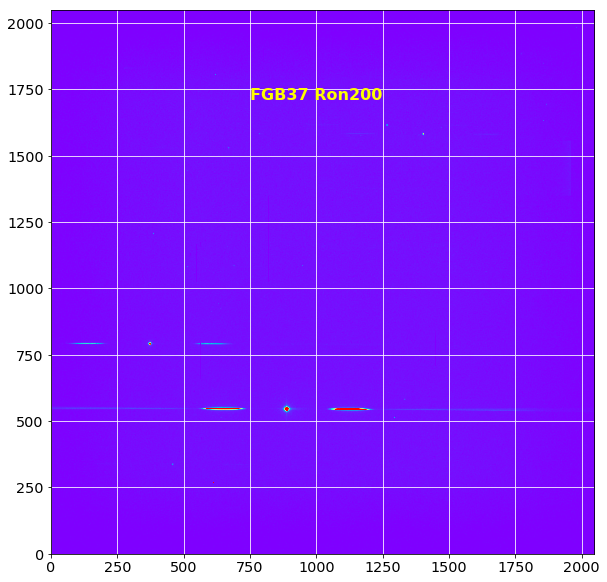

In [16]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

### Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to paly with the parameter below to find a common region to find the central star

In [17]:
# first rough estimate of the maximum
x0,y0=guess_init_fit(all_images[sel_index],500,1100,500,1100)

In [18]:
dw=200  # width

In [19]:
print "x0,y0=",x0,y0

x0,y0= 887 547


In [20]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [21]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [22]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [23]:
z=cropped_image[y,x]

### Show the pre-selected subimage

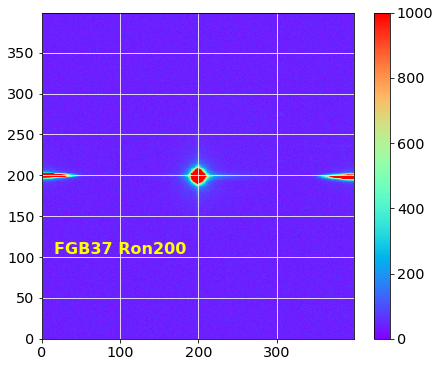

In [24]:
# plot x,y,z
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [25]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 60448.4280627


### Make the 2D fit

In [26]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [27]:
import warnings
p = fit_p(p_init, x, y, z)

In [28]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=199.697729825)
Parameter('y_mean', value=199.229962841)
Parameter('amplitude', value=80614.2694567)


In [29]:
new_x0=p.x_mean
new_y0=p.y_mean

### Show result of 2D gaussian fit

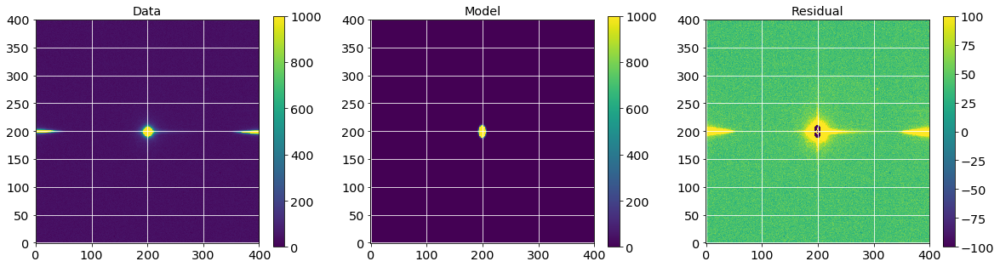

In [30]:
plt.figure(figsize=(20, 5))
#subplot 1
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Data")
#subplot 2
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Model")
#subplot 3
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

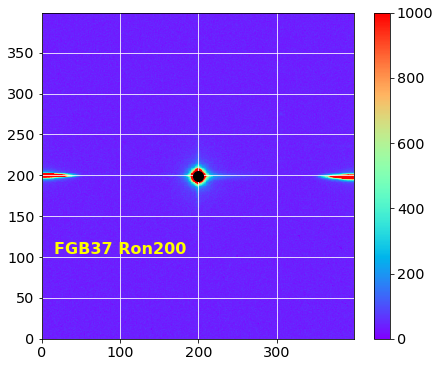

In [31]:
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=10)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

## Show the images at Input

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

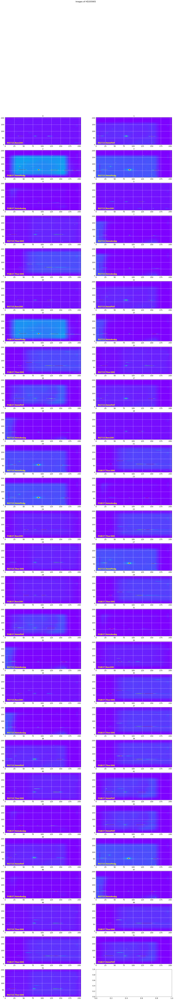

In [32]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=1000,downsampling=10,verbose=True)

figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

## Show the histograms of input images

- just check the reduction and deflattage is OK

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

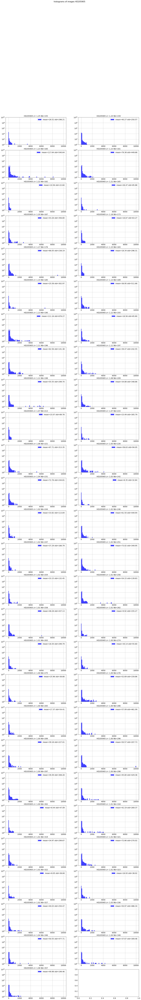

In [33]:
ShowHistograms(all_images,all_titles,all_filt,object_name,
               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

##  Guess central position of the central star in original image

- defines two utility functions


### Compute the position of central star

** Please the the area for the central star here **

In [34]:
# guess the region where the maximum is
Delta_x0=[750,1000]
Delta_y0=[500,750]
dwc=125

x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx)

0 : (x_guess,y_guess)= 810.838993035 636.795972312
1 : (x_guess,y_guess)= 813.180411526 634.811031373
2 : (x_guess,y_guess)= 902.266062506 574.569893858
3 : (x_guess,y_guess)= 903.418712968 574.625570922
4 : (x_guess,y_guess)= 902.635832474 574.286966424
5 : (x_guess,y_guess)= 813.96669537 633.031656328
6 : (x_guess,y_guess)= 814.046839524 634.156736275
7 : (x_guess,y_guess)= 901.917119699 572.747920637
8 : (x_guess,y_guess)= 811.032276922 629.883086732
9 : (x_guess,y_guess)= 900.973838027 569.519552856
10 : (x_guess,y_guess)= 809.994613836 628.872828091
11 : (x_guess,y_guess)= 810.32553351 628.762787599
12 : (x_guess,y_guess)= 899.049492081 566.920250195
13 : (x_guess,y_guess)= 899.246132502 566.875435479
14 : (x_guess,y_guess)= 807.021062283 625.743693124
15 : (x_guess,y_guess)= 808.5788285 625.898174486
16 : (x_guess,y_guess)= 806.964054331 622.343608805
17 : (x_guess,y_guess)= 807.712852624 621.566976397
18 : (x_guess,y_guess)= 897.253511304 560.770700191
19 : (x_guess,y_guess)= 80

/Users/dagoret/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


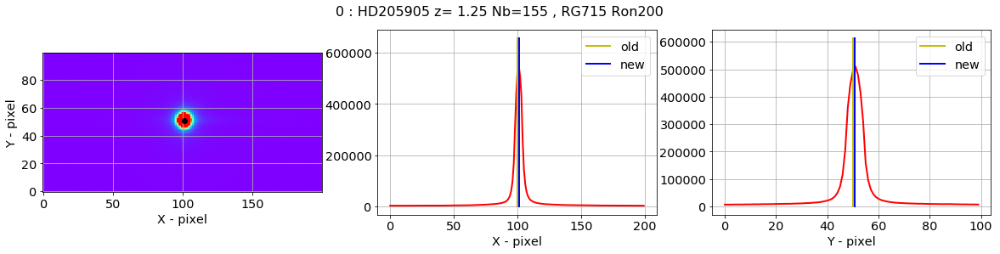

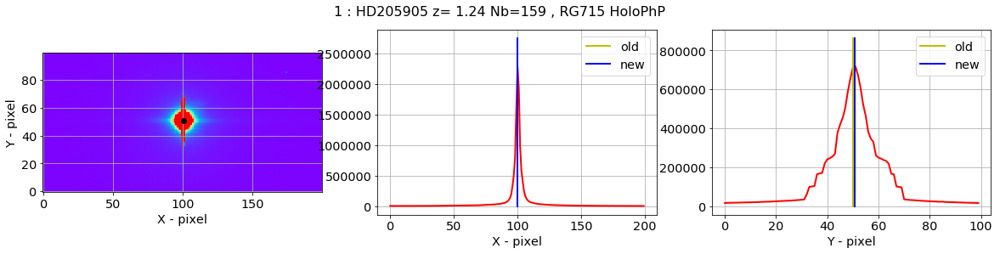

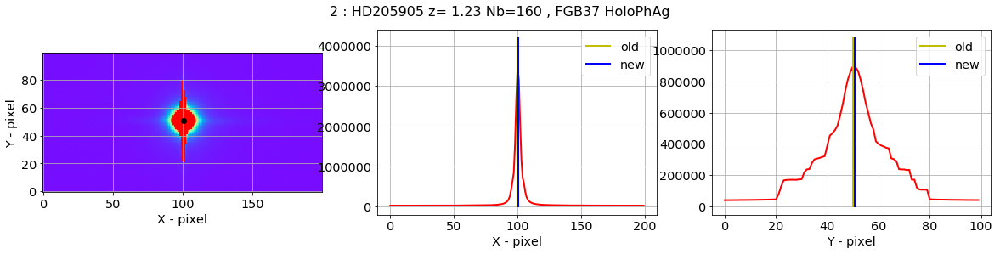

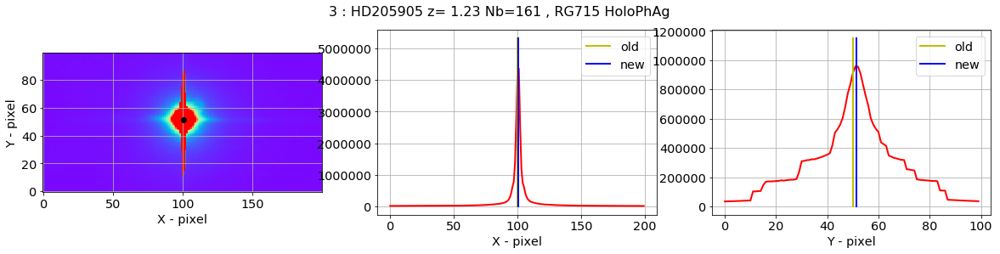

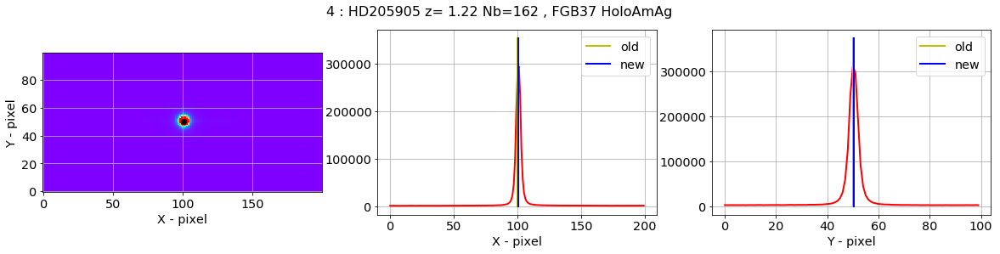

...

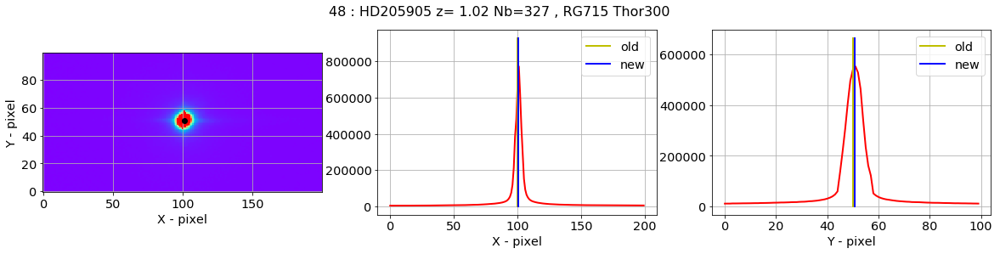

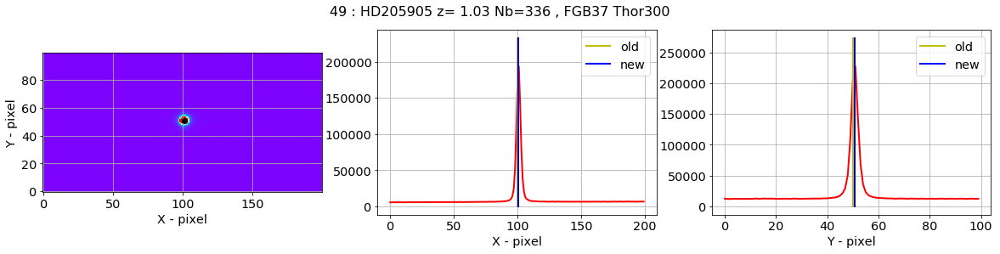

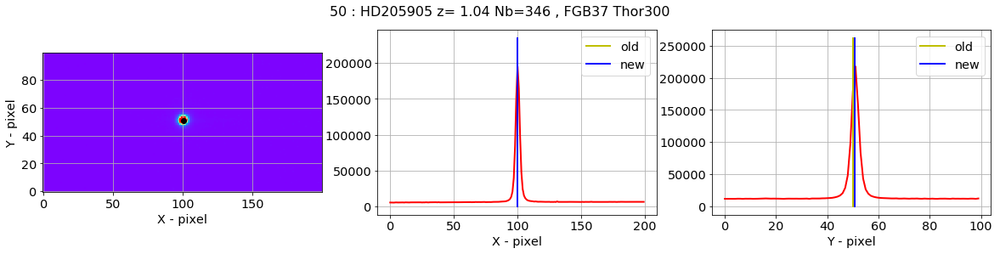

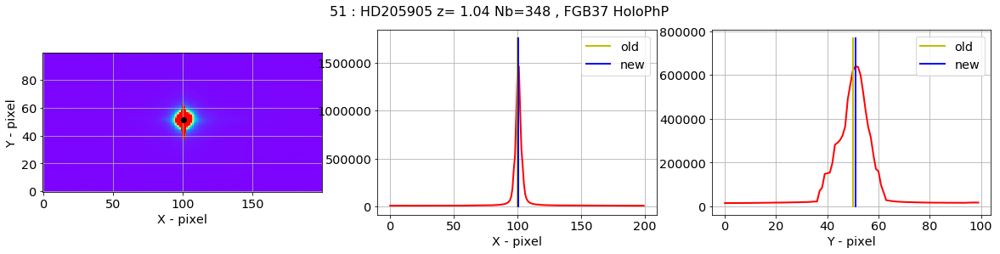

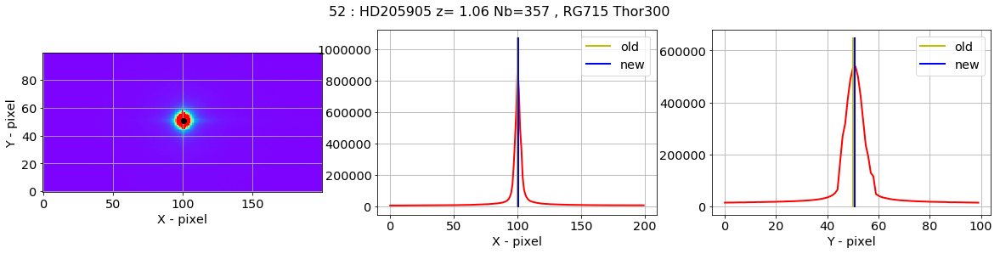

In [35]:
new_x_guess,new_y_guess=check_central_star(all_images,x_guess,y_guess,all_titles,all_filt,Dx=100,Dy=50)

### Check corrections of the center

In [36]:
dx_guess=new_x_guess-x_guess
dy_guess=new_y_guess-y_guess

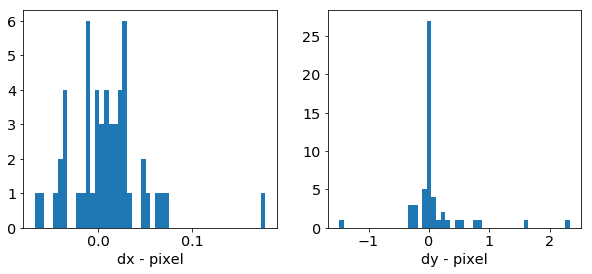

In [37]:
f, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))
ax1.hist(dx_guess,bins=50);
ax1.set_xlabel("dx - pixel")
ax2.hist(dy_guess,bins=50);
ax2.set_xlabel("dy - pixel")

In [38]:
x_guess=new_x_guess
y_guess=new_y_guess

## Save x_guess, y_guess in a file

In [39]:
ar = {'x_guess' : x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [40]:
df.head()

,x_guess,y_guess
0,810.867649,636.809005
1,813.171528,634.613480
2,902.230030,574.581744
3,903.444644,575.474133
4,902.640341,574.293659


In [41]:
df.tail()

,x_guess,y_guess
48,785.828857,595.741560
49,784.734529,594.661085
50,782.094482,592.877030
51,782.545668,591.155210
52,783.203001,593.560125


In [42]:
df.describe()

,x_guess,y_guess
count,53.000000,53.000000
mean,834.447997,590.931124
std,46.396154,30.871326
min,782.094482,534.987431
25%,796.826549,566.633222
50%,809.993094,596.713533
75%,889.053421,612.439191
max,903.444644,636.809005


In [43]:
df.to_csv('x_y_guess.csv')

## Finally cut image

- before rotation

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

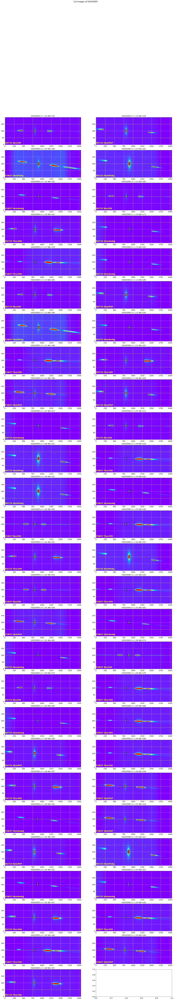

In [44]:
DeltaY=[100]*len(all_images)
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

## Save cut images
------------------------

- save the series of cut images called **images_raw** in a file


In [45]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

!ls -l cut_fitsimages/*

-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_155.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_159.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_160.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_161.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_162.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_165.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_167.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_20170608_173.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 16:22 cut_fitsimages/cutimg_2

---------------------------------------------------------------------------------
# Section 2 : Find the rotation angle and apply rotation
----------------------------------------------------------------------------------

## Initialisation of Section 2
----------------------------------

In [46]:
inputdir="./cut_fitsimages"
SelectTagRe='^cutimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^cutimg_%s_[0-9]+.fits$' % date

outputdir="./rotated_fitsimages"
ensure_dir(outputdir)

sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 53


In [47]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

In [48]:
df=pd.read_csv('x_y_guess.csv')
x_guess=df["x_guess"]
y_guess=df["y_guess"]
DeltaY=[100]*len(all_images)

In [49]:
df.head()

,Unnamed: 0,x_guess,y_guess
0,0,810.867649,636.809005
1,1,813.171528,634.613480
2,2,902.230030,574.581744
3,3,903.444644,575.474133
4,4,902.640341,574.293659


## Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

### Test rotation optimal settings

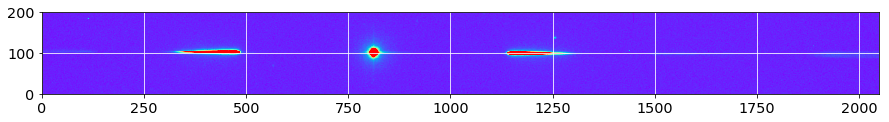

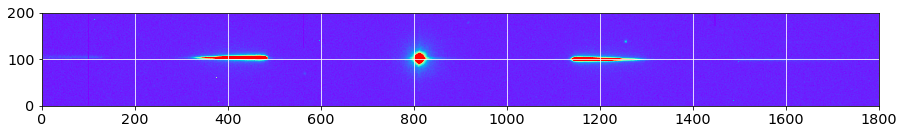

In [50]:
sel=0
image_sel=np.copy(all_images[sel])
y0=DeltaY[sel]
x0=x_guess[sel]

width_cut = 100
right_edge = 1800

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,0:right_edge])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

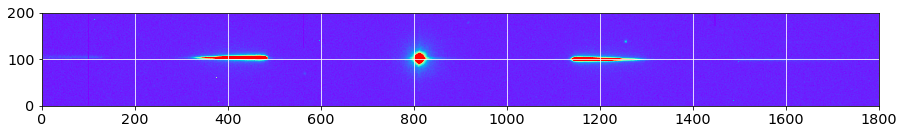

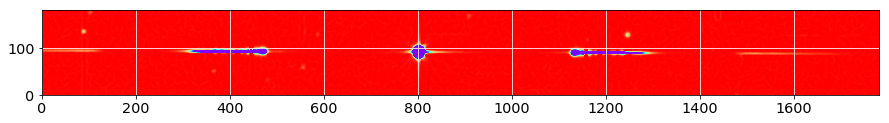

In [51]:
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

margin_cut = 10

lambda_minus = lambda_minus[margin_cut:-margin_cut,margin_cut:-margin_cut]
lambda_plus = lambda_plus[margin_cut:-margin_cut,margin_cut:-margin_cut]
theta = theta[margin_cut:-margin_cut,margin_cut:-margin_cut]

plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-10,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Number of remaining pixels : 4457


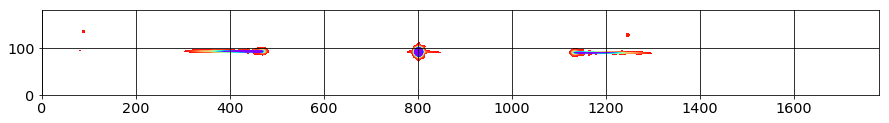

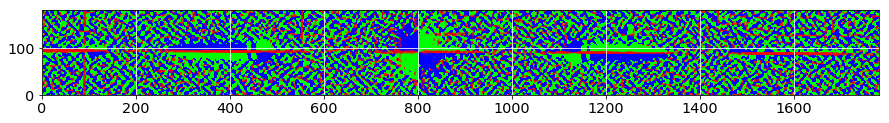

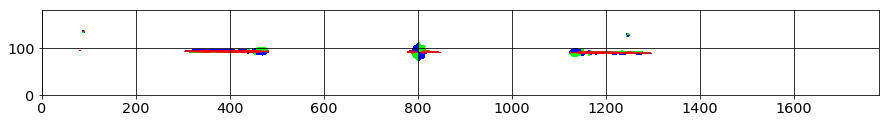

In [52]:
lambda_threshold = -2

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

Number of remaining pixels : 2630


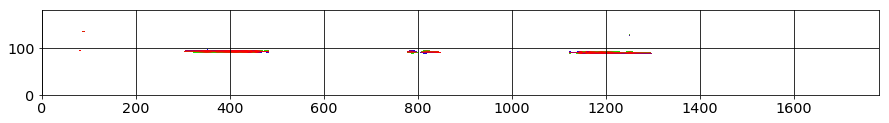

In [53]:
deg_threshold = 20

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.231574486969


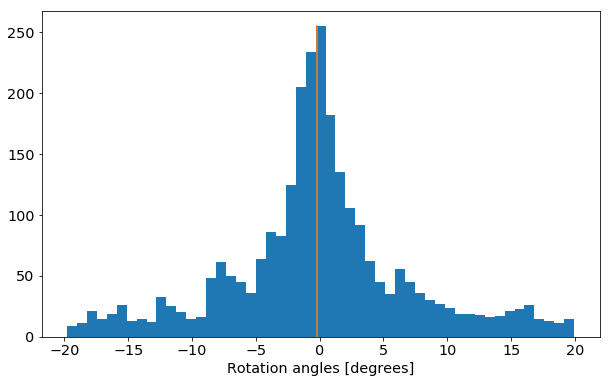

In [54]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

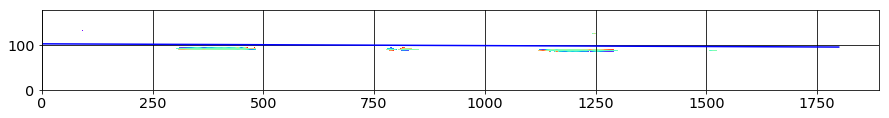

In [55]:
xindex=np.arange(data.shape[1])
x_new = np.linspace(xindex.min(),xindex.max(), 50)
#y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
# really want to see of hessian an straight line math SDC : Sept 25 2017
y_new = y0   + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()


Rotation angle from fit : -0.23733914363


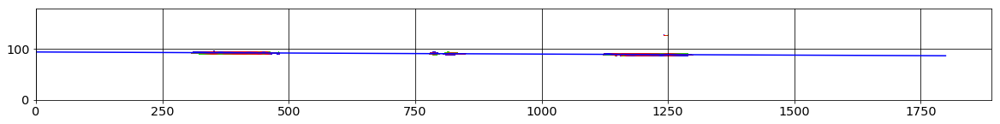

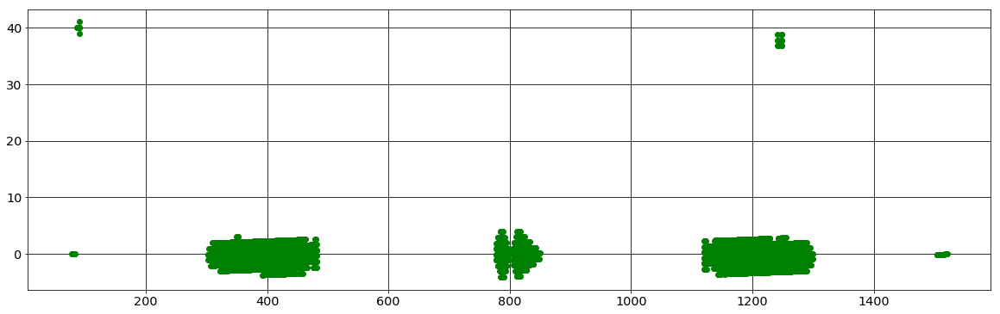

In [56]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>deg_threshold : continue
            xtofit.append(ix)
            ytofit.append(iy)
popt, pcov = fit_line(xtofit, ytofit)
[a, b] = popt
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = line(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,6])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
fig = plt.figure(figsize=[20,6])
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-line(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Using Hessian theta angles:
0  theta =  -0.24478039603
1  theta =  -1.06067369412
2  theta =  -1.99646196184
3  theta =  -1.71244246318
4  theta =  -1.41433908664
5  theta =  -0.353177055999
6  theta =  -0.426884605927
7  theta =  -1.28231128768
8  theta =  -0.4869445424
9  theta =  -1.34062301799
10  theta =  -0.326318647673
11  theta =  -1.08984966953
12  theta =  -1.98802894601
13  theta =  -1.28433546785
14  theta =  -0.45428801806
15  theta =  -0.4535730834
16  theta =  -1.03096889119
17  theta =  -1.00939416416
18  theta =  -1.29077943618
19  theta =  -0.176441753983
20  theta =  -1.63194294652
21  theta =  -0.551949541508
22  theta =  -1.6164437701
23  theta =  -1.51450545669
24  theta =  -0.290272540755
25  theta =  -0.52619188791
26  theta =  -0.45159626578
27  theta =  -1.58760155927
28  theta =  -0.210665316377
29  theta =  -0.454431915155
30  theta =  -1.02297482255
31  theta =  -1.53426557472
32  theta =  -1.40458154361
33  theta =  -0.22314466215
34  theta =  -0.295105465

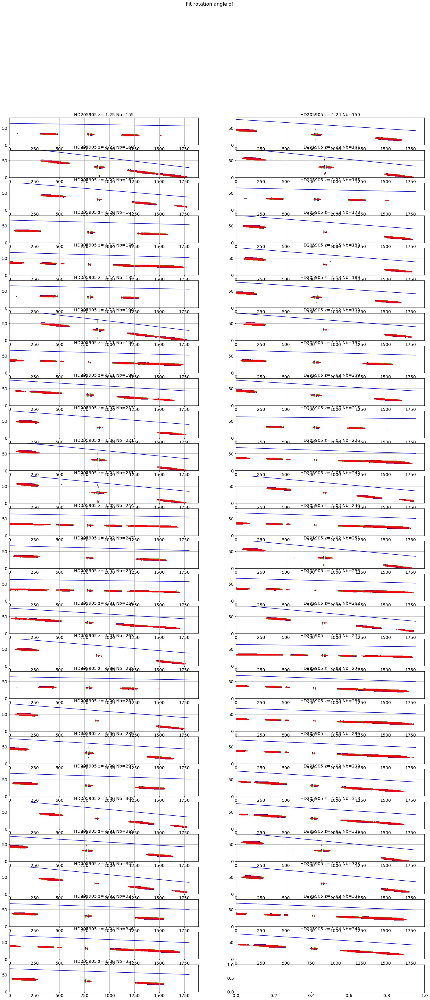

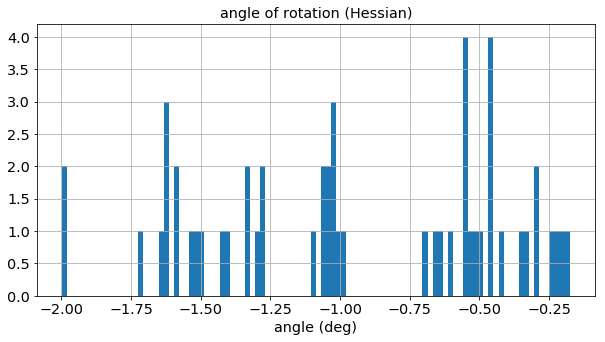

In [57]:
print 'Using Hessian theta angles:'

all_theta=ComputeRotationAngleHessian(all_images,x_guess,DeltaY,all_titles,object_name, 
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 40, right_edge = 1800, margin_cut = 10)
figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
plt.savefig(figfilename)  

for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index]
plt.figure(figsize=(10,5))
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

## Turn the images accordingly

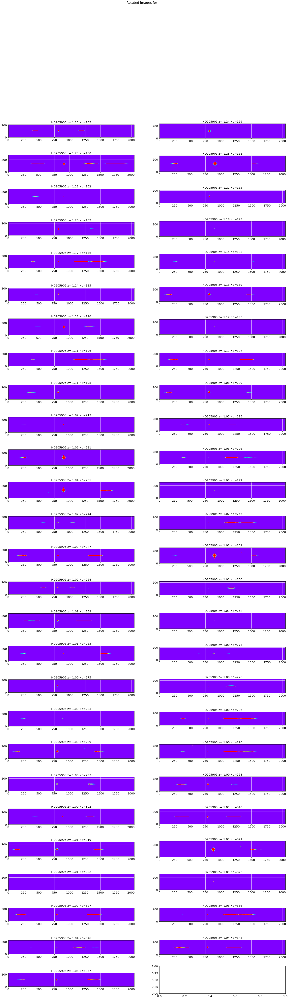

In [58]:
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,
                            NBIMGPERROW=2,vmin=500,vmax=1000,oversample_factor=1)
figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
plt.savefig(figfilename)  

## Check rotations

array([ 0.01616581,  0.05826489,  0.14198785,  0.08323366,  0.06825219,
        0.15533322,  0.00158092,  0.05651634,  0.01872046,  0.06001534,
       -0.01388728,  0.00986847,  0.10371776,  0.16337363, -0.02237809,
        0.03750616, -0.03265604, -0.01878985,  0.04655376, -0.08097077,
       -0.0789389 ,  0.04327479, -0.07104298,  0.0878309 ,  0.00135816,
        0.02356783,  0.22260498, -0.12091351, -0.01572275,  0.0328689 ,
        0.06225373,  0.10636977,  0.09323406,  0.03008108,  0.13980963,
        0.00460507,  0.09025163,  0.02839972,  0.0651935 ,  0.03887706,
       -0.00591229,  0.06001601,  0.05120205,  0.05718963, -0.04859982,
       -0.2933801 ,  0.07460509,  0.18810606, -0.06925933,  0.03961518,
        0.01915217,  0.05837185,  0.01830762])

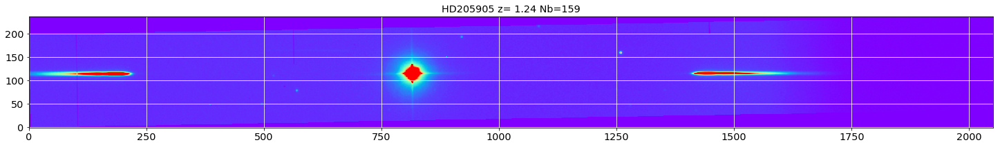

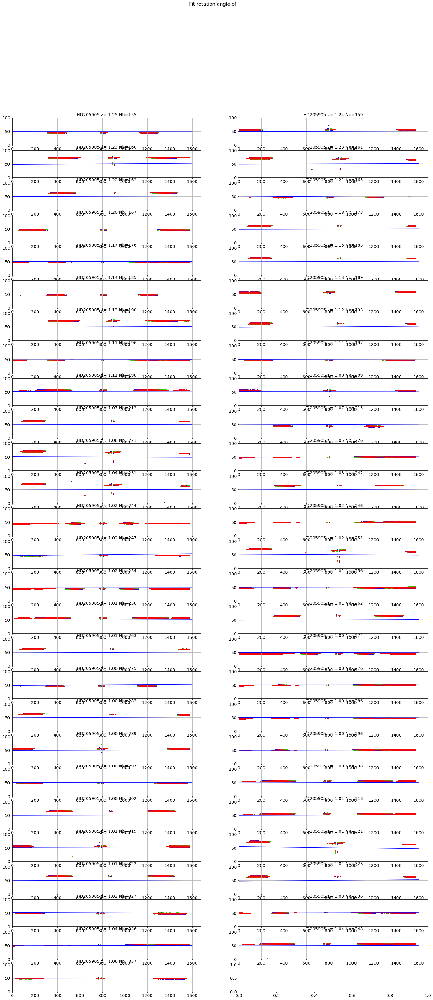

In [59]:
sel=1
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

ComputeRotationAngleHessian(turned_images,x_guess,DeltaY,all_titles,object_name,
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 50, right_edge = 1600, margin_cut = 10)

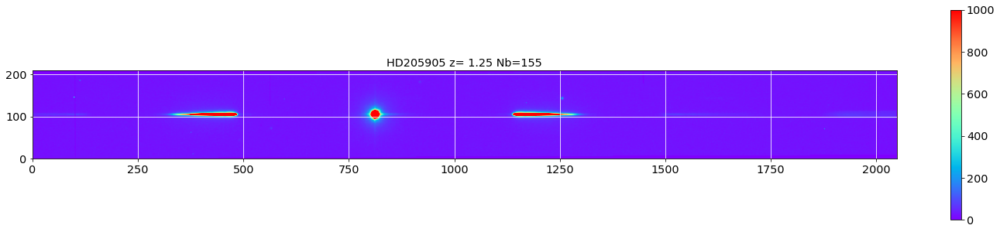

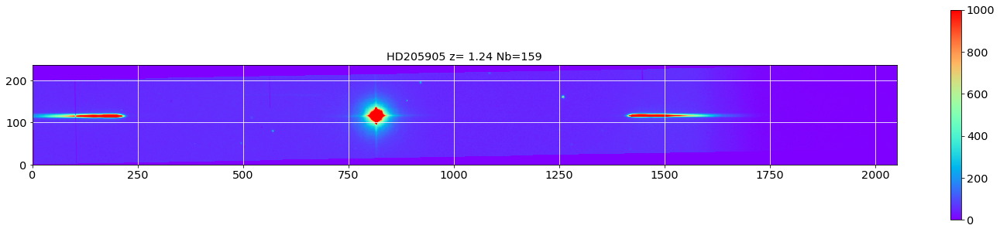

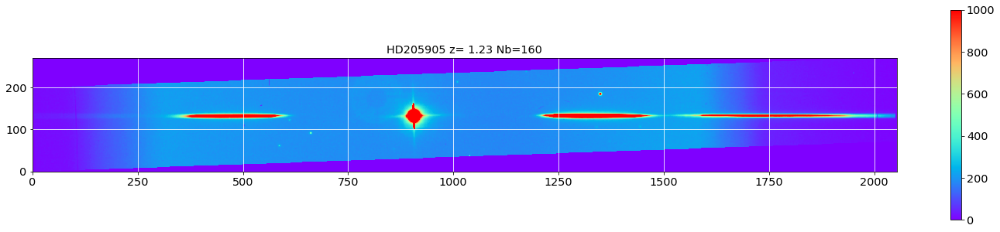

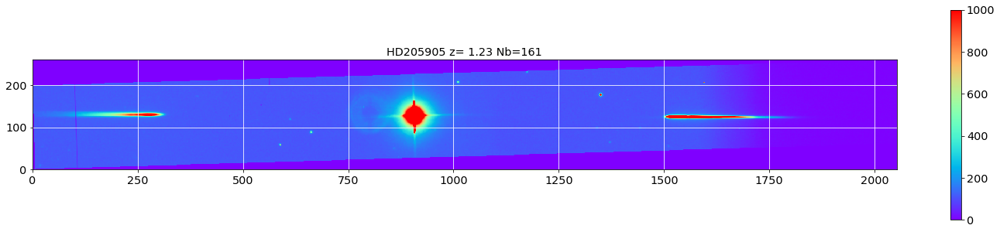

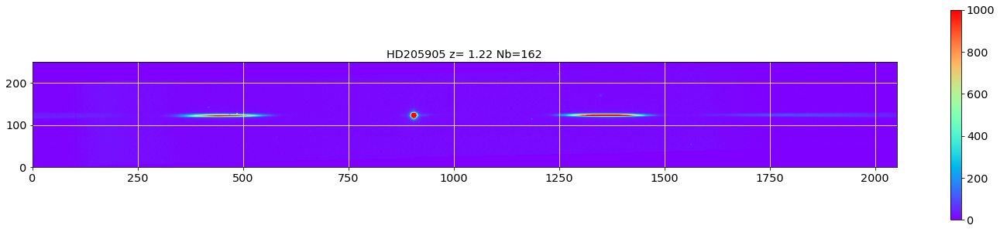

...

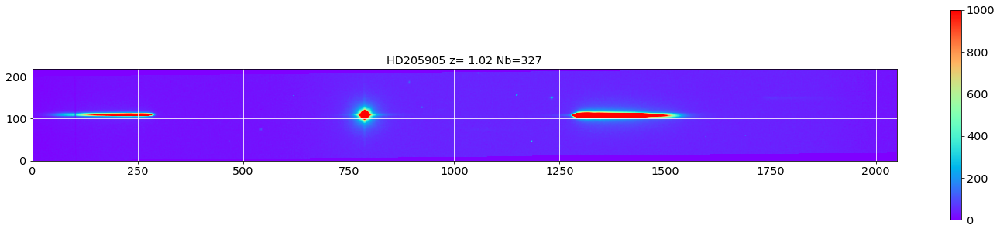

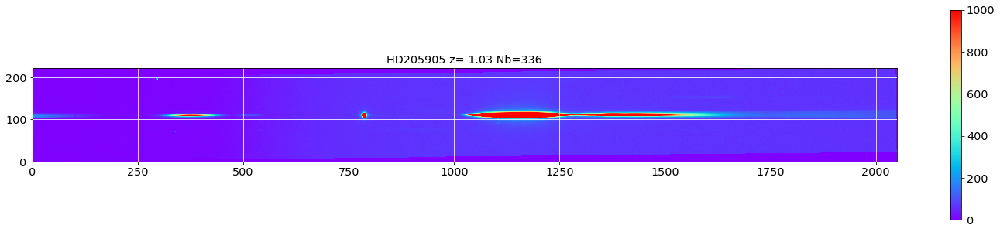

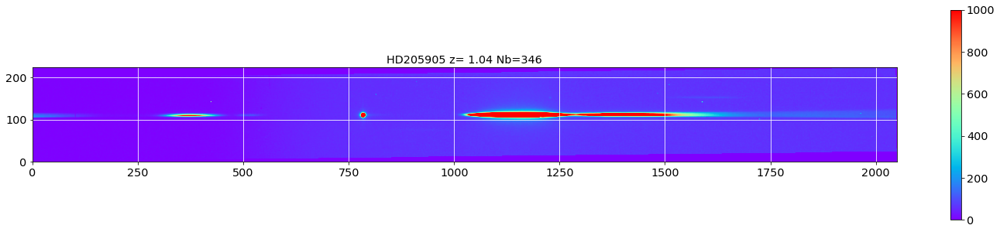

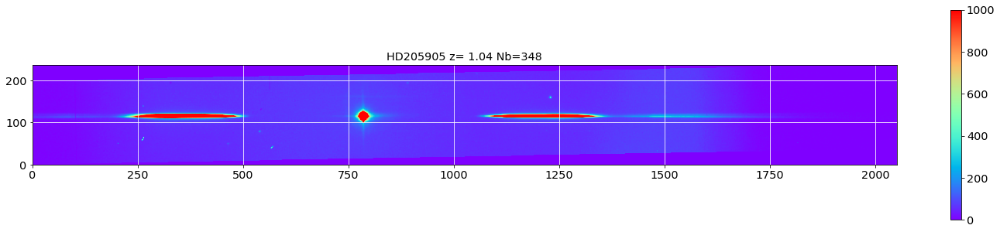

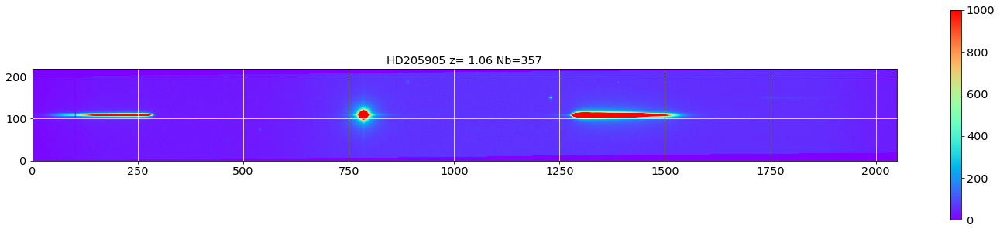

In [60]:
debug=True
if debug:
    for sel in range(len(turned_images)):
        plt.figure(figsize=(25,5))
        plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
        plt.grid(True)
        plt.title(all_titles[sel])
        plt.grid(color='white', ls='solid')
        plt.colorbar()

## Must guess again the new centers for rotation

In [61]:
# guess the region where the maximum is
Delta_x02=[500,1100]
Delta_y02=[50,150]
dwc2=40

In [62]:
turned_images[0].shape

(209, 2049)

In [63]:
guess_init_fit(turned_images[0],Delta_x02[0],Delta_x02[1],Delta_y02[0],Delta_y02[1])

(811, 104)

### Initial guess

In [64]:
x_guess2,y_guess2=guess_central_position(turned_images,Delta_x02,Delta_y02,dwc2,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx)

0 : (x_guess,y_guess)= 811.337440413 104.387164076
1 : (x_guess,y_guess)= 814.697886961 115.89327946
2 : (x_guess,y_guess)= 905.30649283 131.862047463
3 : (x_guess,y_guess)= 905.967480636 126.649325315
4 : (x_guess,y_guess)= 904.654977508 122.304768719
5 : (x_guess,y_guess)= 814.464791801 106.241081783
6 : (x_guess,y_guess)= 814.552359458 106.096578876
7 : (x_guess,y_guess)= 903.917556586 121.024793968
8 : (x_guess,y_guess)= 812.042627081 107.58363231
9 : (x_guess,y_guess)= 902.981976971 121.650614708
10 : (x_guess,y_guess)= 810.491469575 105.655843673
11 : (x_guess,y_guess)= 811.839276006 116.197029104
12 : (x_guess,y_guess)= 902.076214824 132.081093073
13 : (x_guess,y_guess)= 901.251350196 121.089803805
14 : (x_guess,y_guess)= 808.032096349 107.032115935
15 : (x_guess,y_guess)= 809.577735303 107.191009396
16 : (x_guess,y_guess)= 808.484657892 114.958259186
17 : (x_guess,y_guess)= 809.248541252 113.853021609
18 : (x_guess,y_guess)= 899.264493229 120.931025455
19 : (x_guess,y_guess)= 8

### Check new guess of turned images

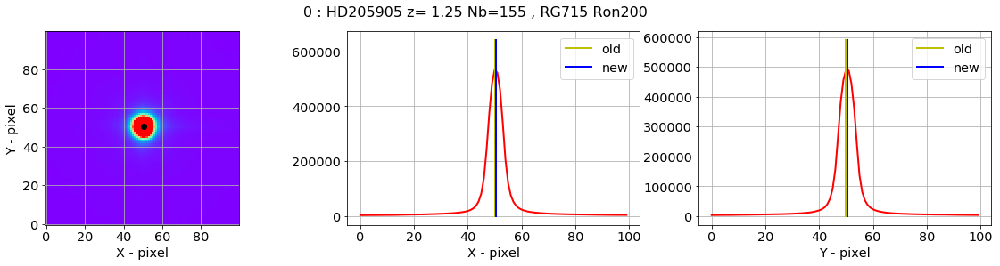

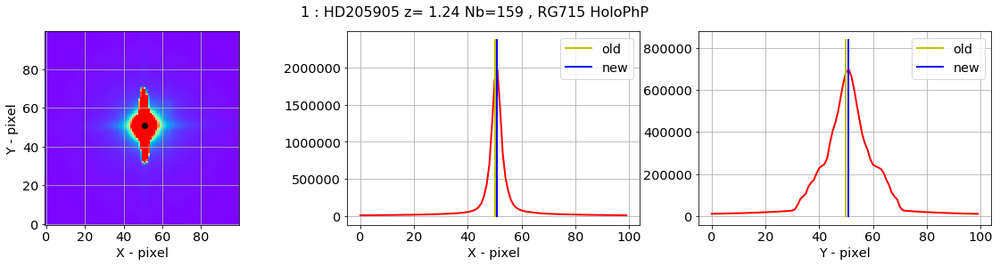

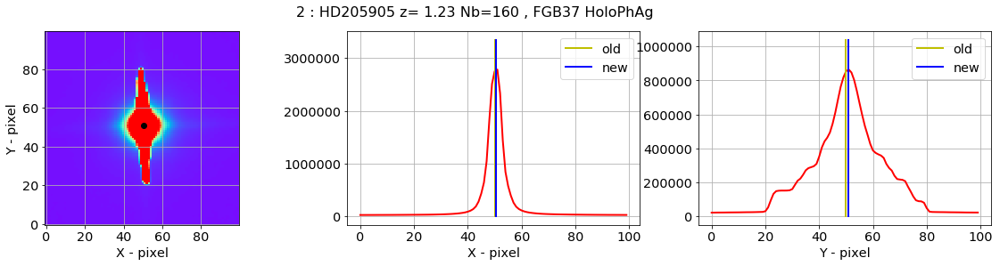

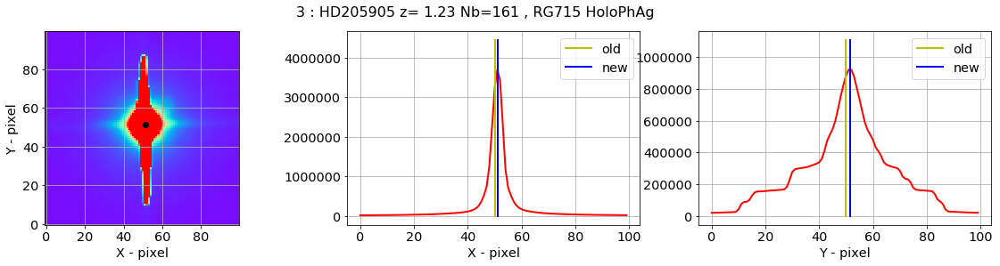

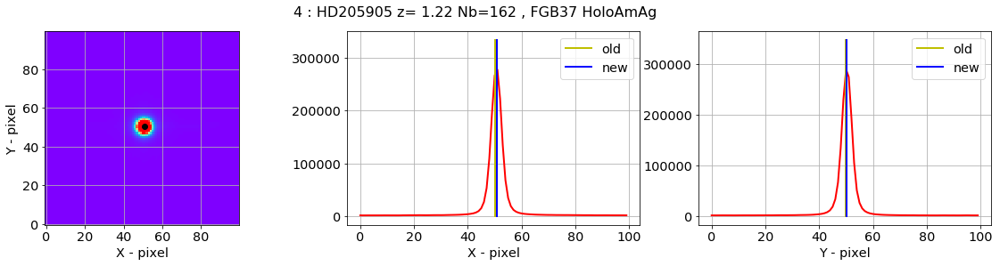

...

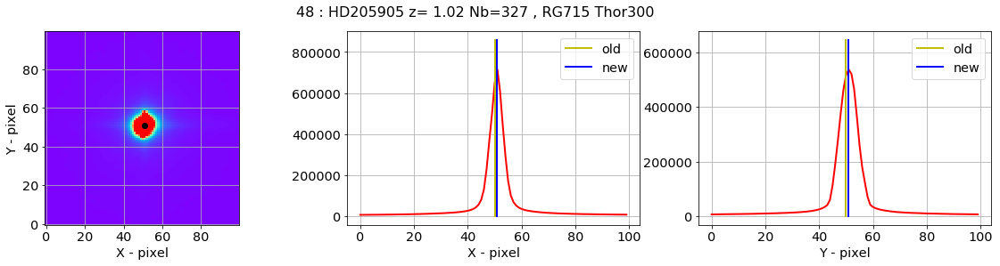

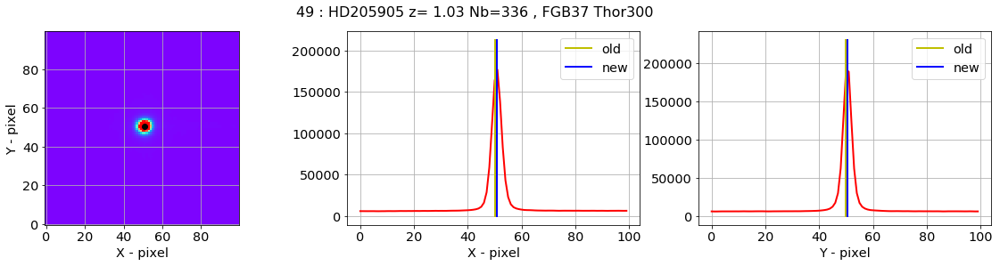

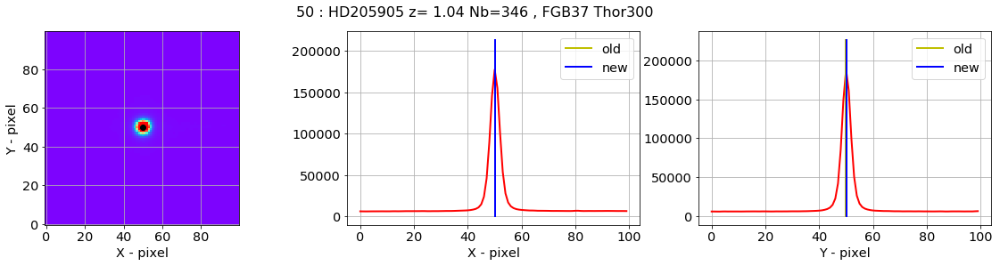

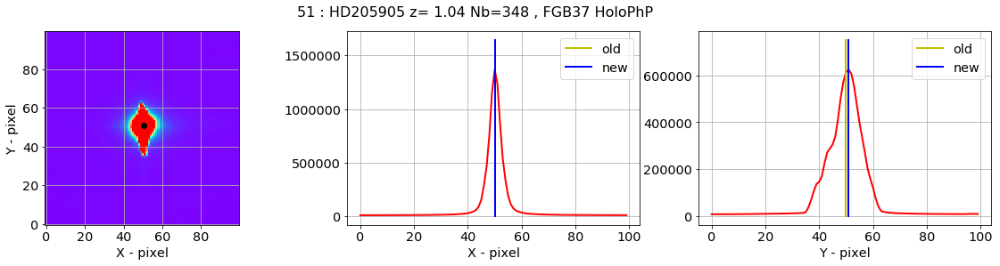

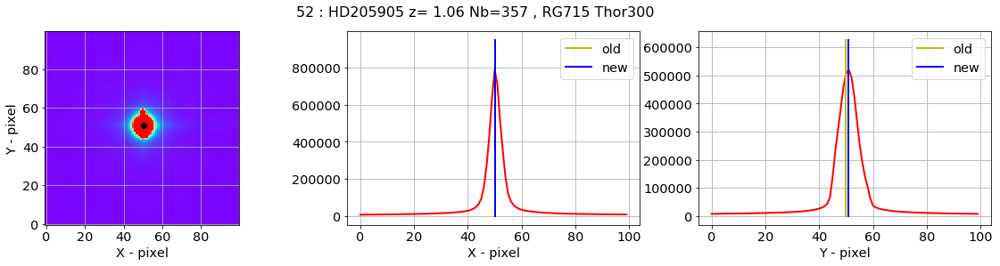

In [65]:
new_x_guess2,new_y_guess2=check_central_star(turned_images,x_guess2,y_guess2,all_titles,all_filt,Dx=50,Dy=50)

In [66]:
x_guess2=new_x_guess2
y_guess2=new_y_guess2

In [67]:
ar2 = {'x_guess2' :x_guess2, 'y_guess2' : y_guess2,'theta' :all_theta}
df2 = pd.DataFrame(ar2)

In [68]:
df2.head()

,theta,x_guess2,y_guess2
0,-0.244780,811.359257,104.402556
1,-1.060674,814.676629,115.723779
2,-1.996462,905.337721,131.870591
3,-1.712442,906.069793,127.413465
4,-1.414339,904.657796,122.312519


In [69]:
df2.to_csv('x_y_guess2.csv')

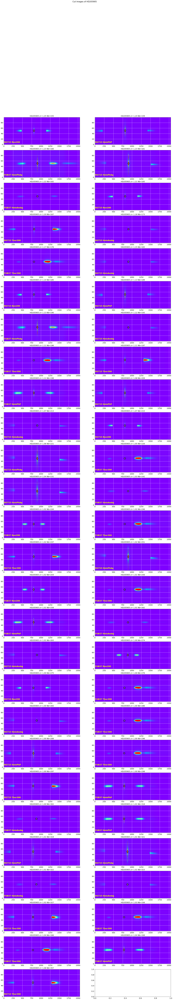

In [70]:
DeltaX=[2000]*len(all_images)
DeltaY_rot2 = [50]*len(all_images) # change from 20 to 50 to see well the central star
x_guess_rot2 = x_guess2
y_guess_rot2 = y_guess2
images_cut_rot=ShowCenterImages(x_guess_rot2,y_guess_rot2,DeltaX,DeltaY_rot2,
                    turned_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess2,y_guess2]).T) 

## Find the central star locations
======================================

### Central star positions after rotation and cut

In [71]:
# Not necessary to do this because already done
CompareBeforeAfterRotFlag=False

if CompareBeforeAfterRotFlag:

    x_guess_rot = x_guess2
    y_guess_rot = y_guess2
    DeltaY_rot = [100]*len(all_images)
    DeltaX_rot = [100]*len(all_images)
    # First stage : show the rotated images which were cut
    print 'First stage : show the rotated images which were cut'
    #--------------------------------------------------------------
    images_cut=ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,
                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess2,y_guess2]).T) 
    # Second stage : show the images cut before they were cut
    print 'Second stage : show the images cut before they were cut'
    #----------------------------------------------------------------
    images_cut_before_rot=ShowCenterImages(x_guess,[100]*len(all_images),DeltaX_rot,DeltaY_rot,
                    all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess,y_guess]).T) 

In [72]:
# DAOFind does not work for me (never)
DAOFindUseFlag=False
    
# (JN) valeurs optimisées pour cette étude
if DAOFindUseFlag:
    img_mean,img_median,img_std,img_sources=ComputeStatImages(images_cut,fwhm=10,threshold=10,sigma=5.0,iters=5)
    print 'total number of images',len(images_cut)
    print 'number of centroid found ',len(img_sources)

## Central star position

- should take the brightest

In [73]:
if DAOFindUseFlag:
    x_star = []
    y_star = []
    for index,s in enumerate(img_sources):
        for ss in s:
            x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
            y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
    x_mean = np.mean(x_star)
    y_mean = np.mean(y_star)
    img_size=all_images[0].shape
    plt.figure(figsize=(5,5))

    # plot individual image center
    plt.plot(x_star,y_star,'o')
    # plot the average postion
    plt.plot(x_mean,y_mean,'ro')
    plt.xlim(0,img_size[1])
    plt.ylim(0,img_size[0])
    plt.grid(True)
    
    print 'nuber of x_star = ',len(x_star)
    print 'nuber of y_star = ',len(y_star)

> The problem is that DAOFIND may not find a center for each source. Thys the only solution
is to do the same thing : computing the average depending on each filter.

In [74]:
if DAOFindUseFlag:
    x_star = []
    y_star = []

    x_star_f0 = []
    y_star_f0 = []

    x_star_f1 = []
    y_star_f1 = []

    x_star_f2 = []
    y_star_f2 = []

    x_star_f3 = []
    y_star_f3 = []

    x_star_f4 = []
    y_star_f4 = []

    missing_centroid = []
    missing_centroid_f0 = []
    missing_centroid_f1 = []
    missing_centroid_f2 = []
    missing_centroid_f3 = []
    missing_centroid_f4 = []


    # loop on all image- source
    for index,s in enumerate(img_sources):
        print "star number :",index
        if len(s) == 0:
            print '!! found no centroid'
            missing_centroid.append(index)
        
            if index in filt0_idx:
                missing_centroid_f0.append(index)
        
            if index in filt1_idx:
                missing_centroid_f1.append(index)
            
            if index in filt2_idx:
                missing_centroid_f2.append(index)   
            
            if index in filt3_idx:
                missing_centroid_f3.append(index)     

            if index in filt4_idx:
                missing_centroid_f4.append(index) 
            
        else:
            print 'found ',len(s),' centroid '
            # loop on individual sources in the image
            for ss in s:
                x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
                if index in filt0_idx:
                    x_star_f0.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f0.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
                if index in filt1_idx:
                    x_star_f1.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f1.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
                if index in filt2_idx:
                    x_star_f2.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f2.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
                
                if index in filt3_idx:
                    x_star_f3.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f3.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])            

                if index in filt4_idx:
                    x_star_f4.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f4.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])        
        
    x_mean = np.mean(x_star)
    y_mean = np.mean(y_star)

    x0_mean = np.mean(x_star_f0)
    y0_mean = np.mean(y_star_f0)



    x1_mean = np.mean(x_star_f1)
    y1_mean = np.mean(y_star_f1)

    x2_mean = np.mean(x_star_f2)
    y2_mean = np.mean(y_star_f2)

    x3_mean = np.mean(x_star_f3)
    y3_mean = np.mean(y_star_f3)

    x4_mean = np.mean(x_star_f4)
    y4_mean = np.mean(y_star_f4)

    print 'SUMMARY ::'
    print '=========='

    print '\t - Found ', len(x_star_f0), ' for filters ',filt_names[0]
    print '\t - Found ', len(x_star_f1), ' for filters ',filt_names[1]
    print '\t - Found ', len(x_star_f2), ' for filters ',filt_names[2]
    print '\t - Found ', len(x_star_f3), ' for filters ',filt_names[3]
    print '\t - Found ', len(x_star_f4), ' for filters ',filt_names[4]

    print '\t - Missing centroids for indexes', missing_centroid
    print '\t - Missing centroids for filter ',filt_names[0], ' : idx = ',missing_centroid_f0
    print '\t - Missing centroids for filter ',filt_names[1], ' : idx = ',missing_centroid_f1
    print '\t - Missing centroids for filter ',filt_names[2], ' : idx = ',missing_centroid_f2
    print '\t - Missing centroids for filter ',filt_names[3], ' : idx = ',missing_centroid_f3
    print '\t - Missing centroids for filter ',filt_names[4], ' : idx = ',missing_centroid_f4

    img_size=all_images[0].shape
    plt.figure(figsize=(15,5))

    # plot individual image center

    # plot the average postion
    plt.plot(x_mean,y_mean,'ro',label='average position')




    plt.plot(x_star_f1,y_star_f1,marker='o',color='lightgreen',label=filt_names[0],lw=0)
    plt.plot(x_star_f2,y_star_f2,marker='o',color='cyan',label=filt_names[1],lw=0)
    plt.plot(x_star_f3,y_star_f3,marker='o',color='orange',label=filt_names[2],lw=0)
    plt.plot(x_star_f4,y_star_f4,marker='o',color='yellow',label=filt_names[3],lw=0)
    plt.plot(x_star_f4,y_star_f0,marker='o',color='magenta',label=filt_names[0],lw=0)

    plt.plot(x_star,y_star,'k+')

    plt.xlim(0,img_size[1])
    #plt.ylim(0,img_size[0])
    plt.ylim(0,200)
    plt.grid(True)
    plt.legend()




### Given DAOFind can find 0 center or more than one, I prefer my guess with a gaussian fit

In [75]:
# Not done because my initial guess is much better
#tmp = ShowCenterImages(x_star,y_star,DeltaX_rot,DeltaY_rot,
#                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

In [76]:
if DAOFindUseFlag:
    tmp = ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

### Zero order positions before rotations

In [77]:
if DAOFindUseFlag:
    DeltaY_rot = [50]*len(all_images)
    DeltaX_rot = [50]*len(all_images)
    y_guess2 = DeltaY
    images_raw_cut=ShowCenterImages(x_guess,y_guess2,DeltaX_rot,DeltaY_rot,
                    images_raw,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

In [78]:
# (JN) valeurs optimisées pour cette étude
if DAOFindUseFlag:
    img_mean,img_median,img_std,img_sources=ComputeStatImages(images_raw_cut,fwhm=7,threshold=10,sigma=10.0,iters=5)

###  Finally the guess in the Section 1 was very good

- Take the determination of original position from section 1 
- Do not use DAOFind peak selection used for Photometry

[[ 810.8676494   636.80900497]
 [ 813.17152758  634.61347974]
 [ 902.23003002  574.5817443 ]
 [ 903.44464448  575.47413259]
 [ 902.64034101  574.29365933]
 [ 813.9289985   632.97842093]
 [ 813.9866739   634.20262756]
 [ 901.9347114   572.76297826]
 [ 811.03081698  629.87516774]
 [ 900.97783337  569.52027318]
 [ 809.99309367  628.91118531]
 [ 810.35131578  628.46122624]
 [ 899.03611068  566.63322227]
 [ 899.247219    566.86628319]
 [ 807.01718164  625.75666013]
 [ 808.54074085  625.69409947]
 [ 806.9524639   622.63104101]
 [ 807.73807907  622.14131721]
 [ 897.21893662  560.81684521]
 [ 807.93408591  619.44197803]
 [ 897.5451294   559.7918227 ]
 [ 805.80282599  616.52862694]
 [ 895.23615537  556.95892446]
 [ 892.72170611  553.09960566]
 [ 804.52857064  612.24572593]
 [ 804.04013077  611.74640837]
 [ 804.59414429  612.4391911 ]
 [ 894.55128353  551.50513773]
 [ 803.47979624  608.10176332]
 [ 801.36914125  608.88063894]
 [ 801.10538814  607.80042916]
 [ 889.05342089  548.16470947]
 [ 890.5

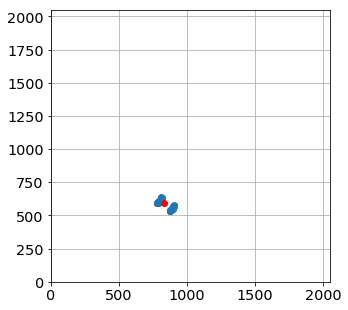

In [79]:
x_pointing = []
y_pointing = []
#for index,s in enumerate(img_sources):
for index in np.arange(len(all_images)):    
    #for ss in s:
    #    x_pointing.append(ss['xcentroid']+x_guess[index]-DeltaX_rot[index])
    #    y_pointing.append(ss['ycentroid']+y_guess[index]-DeltaY_rot[index])
    x_pointing.append(x_guess[index])
    y_pointing.append(y_guess[index])
    
        
x_mean = np.mean(x_pointing)
y_mean = np.mean(y_pointing)
img_size=all_images[0].shape
order0_positions = np.array([x_pointing,y_pointing]).T
print order0_positions

plt.figure(figsize=(5,5))
plt.plot(order0_positions.T[0],order0_positions.T[1],'o')
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,IMSIZE)
plt.ylim(0,IMSIZE)
plt.grid(True)

#####  cherche le nom de l'hologramme

In [80]:
print all_filt

['RG715 Ron200', 'RG715 HoloPhP', 'FGB37 HoloPhAg', 'RG715 HoloPhAg', 'FGB37 HoloAmAg', 'RG715 Ron200', 'RG715 Thor300', 'RG715 HoloAmAg', 'FGB37 Thor300', 'RG715 HoloAmAg', 'RG715 Ron200', 'RG715 HoloPhP', 'FGB37 HoloPhAg', 'RG715 HoloAmAg', 'FGB37 Thor300', 'RG715 Thor300', 'FGB37 HoloPhP', 'RG715 HoloPhP', 'RG715 HoloAmAg', 'RG715 Ron200', 'RG715 HoloPhAg', 'FGB37 Thor300', 'RG715 HoloPhAg', 'FGB37 HoloAmAg', 'FGB37 Ron200', 'FGB37 Thor300', 'RG715 Thor300', 'RG715 HoloPhAg', 'FGB37 Ron200', 'FGB37 Thor300', 'FGB37 HoloPhP', 'FGB37 HoloAmAg', 'RG715 HoloAmAg', 'FGB37 Ron200', 'RG715 Ron200', 'FGB37 Thor300', 'RG715 HoloAmAg', 'FGB37 Thor300', 'RG715 HoloPhP', 'FGB37 Thor300', 'RG715 Thor300', 'FGB37 HoloPhP', 'FGB37 HoloAmAg', 'FGB37 HoloPhP', 'RG715 HoloPhP', 'RG715 HoloPhAg', 'FGB37 HoloAmAg', 'RG715 HoloAmAg', 'RG715 Thor300', 'FGB37 Thor300', 'FGB37 Thor300', 'FGB37 HoloPhP', 'RG715 Thor300']


In [81]:
all_grat = []
for f in all_filt2 :
    #all_grat.append(f.replace('RG715 ',''))
    #all_grat.append(f.replace('dia ',''))
    all_grat.append(f)
for index,g in enumerate(all_grat):
    holo = Hologram(g,verbose=False)
    print g,holo.theta(order0_positions[index]), all_theta[index]

Ron200 0 -0.24478039603
HoloPhP [-1.01476022] -1.06067369412
HoloPhAg [-1.92334497] -1.99646196184
HoloPhAg [-1.92192208] -1.71244246318
HoloAmAg [-1.9489722] -1.41433908664
Ron200 0 -0.353177055999
Thor300 -0.575 -0.426884605927
HoloAmAg [-1.95245117] -1.28231128768
Thor300 -0.575 -0.4869445424
HoloAmAg [-1.95973272] -1.34062301799
Ron200 0 -0.326318647673
HoloPhP [-1.01646334] -1.08984966953
HoloPhAg [-1.94022978] -1.98802894601
HoloAmAg [-1.96600598] -1.28433546785
Thor300 -0.575 -0.45428801806
Thor300 -0.575 -0.4535730834
HoloPhP [-1.01804398] -1.03096889119
HoloPhP [-1.01867831] -1.00939416416
HoloAmAg [-1.97990903] -1.29077943618
Ron200 0 -0.176441753983
HoloPhAg [-1.95579351] -1.63194294652
Thor300 -0.575 -0.551949541508
HoloPhAg [-1.96188051] -1.6164437701
HoloAmAg [-1.99874318] -1.51450545669
Ron200 0 -0.290272540755
Thor300 -0.575 -0.52619188791
Thor300 -0.575 -0.45159626578
HoloPhAg [-1.97493262] -1.58760155927
Ron200 0 -0.210665316377
Thor300 -0.575 -0.454431915155
HoloPhP 

## Save results on rotated images

- Save the cut images after rotation
- Save also info on the position

In [82]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_cut_rot[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)
textfilename=os.path.join(outputdir,'star_centroids.txt')
print textfilename
np.savetxt(textfilename,order0_positions,header="y_star x_star",fmt='%d')

!ls -l rotated_fitsimages

./rotated_fitsimages/star_centroids.txt
total 170880
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_155.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_159.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_160.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_161.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_162.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_165.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_167.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_173.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 16:24 rotimg_20170608_176.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  

In [83]:
ar3 = {'x_pointing' :x_pointing, 'y_pointing' : y_pointing,'theta' :all_theta}
df3 = pd.DataFrame(ar3)

In [84]:
df3.to_csv('xy_pointing.csv')

In [85]:
df3

,theta,x_pointing,y_pointing
0,-0.244780,810.867649,636.809005
1,-1.060674,813.171528,634.613480
2,-1.996462,902.230030,574.581744
3,-1.712442,903.444644,575.474133
4,-1.414339,902.640341,574.293659
5,-0.353177,813.928998,632.978421
6,-0.426885,813.986674,634.202628
7,-1.282311,901.934711,572.762978
8,-0.486945,811.030817,629.875168
9,-1.340623,900.977833,569.520273


## End of Section 2 on rotation

- The following section will be removed.

- At this stage it is recommended to go to **Ana2DShapeSpectra** notebook

-------------------------------------------------------
# Section 3 : Extract spectra
---------------------------------------------------------

## Initialisation of Section 3

In [86]:
outputdir="./spectrum_fitsspec"
ensure_dir(outputdir)

inputdir="./rotated_fitsimages"
SelectTagRe='^rotimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^rotimg_%s_[0-9]+.fits$' % date

### Get coordinate of order zero before rotation

In [87]:
df=pd.read_csv('xy_pointing.csv')

In [88]:
df.head()

,Unnamed: 0,theta,x_pointing,y_pointing
0,0,-0.244780,810.867649,636.809005
1,1,-1.060674,813.171528,634.613480
2,2,-1.996462,902.230030,574.581744
3,3,-1.712442,903.444644,575.474133
4,4,-1.414339,902.640341,574.293659


In [89]:
x_star=df["x_pointing"]
y_star=df["y_pointing"]

### Get coordinate of order zero after cut and rotation (in file)

In [90]:
df2=pd.read_csv('x_y_guess2.csv')

In [91]:
df2.head()

,Unnamed: 0,theta,x_guess2,y_guess2
0,0,-0.244780,811.359257,104.402556
1,1,-1.060674,814.676629,115.723779
2,2,-1.996462,905.337721,131.870591
3,3,-1.712442,906.069793,127.413465
4,4,-1.414339,904.657796,122.312519


In [92]:
x_star2=df2["x_guess2"]
y_star2=df2["y_guess2"]

In [94]:
sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 53


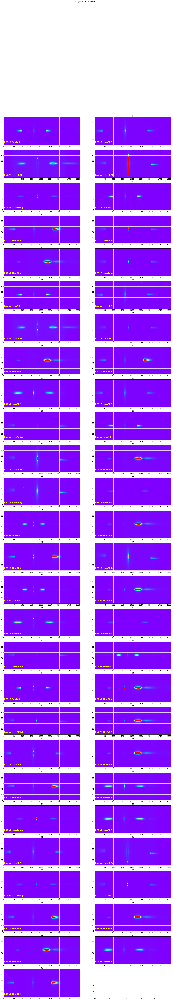

In [95]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

## Extraction of the spectrum from the 2D - Images


### Check the transverse spectrum does not show multi-bum

This proves the rotation may be OK

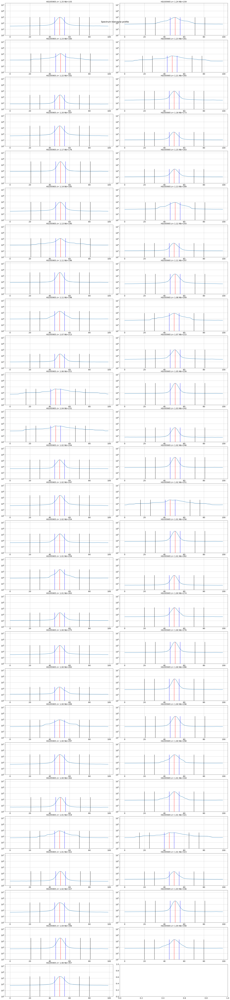

In [96]:
they0=ShowTransverseProfile(all_images,all_titles,object_name,all_expo,NBIMGPERROW=2,
                      DeltaX=1000,w=5,ws=[20,30],right_edge=1800,ylim=(1e2,2e7))

## Extract the longitudinal spectrum with its lateral bands

In [100]:
thespectra,thespectraUp,thespectraDown=ExtractSpectra(they0,all_images,all_titles,object_name,all_expo,
                                                      w=3,ws=[10,30],right_edge=1800)

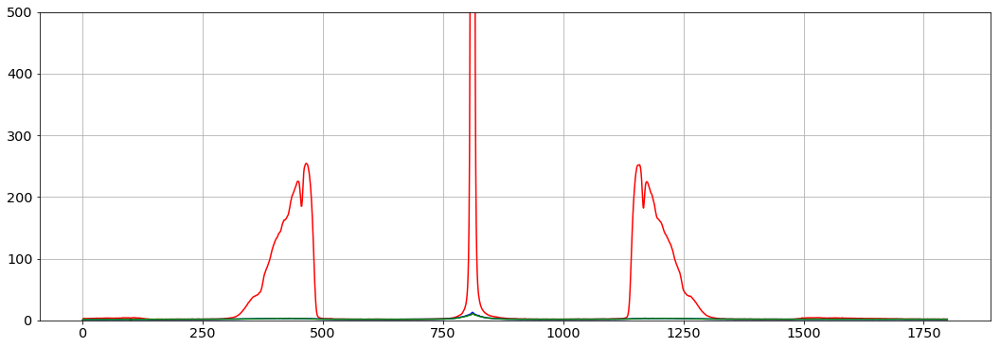

In [99]:
sel=0
plt.figure(figsize=(18,6))
plt.plot(thespectra[sel],'r-') 
plt.plot(thespectraUp[sel],'b-') 
plt.plot(thespectraDown[sel],'g-')
#plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,500.)
figfilename=os.path.join(dir_top_images,'bckg_sample.pdf')
plt.savefig(figfilename) 

In [101]:
thespectraAv=np.array(thespectraUp+thespectraDown)/2.


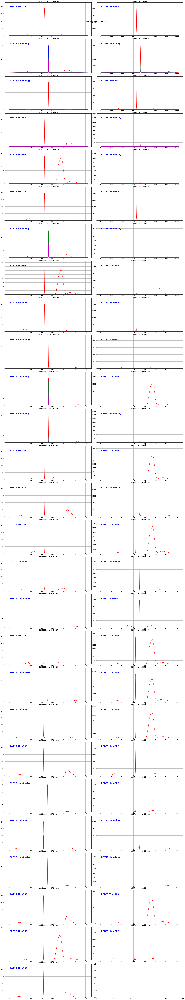

In [102]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)

In [103]:
import math as m
from matplotlib.backends.backend_pdf import PdfPages
def ShowFullLongitBackground(spectra,spectraUp,spectraDown,spectraAv,all_titles,object_name,NBIMGPERROW,dir_top_images):
    """
    Show the background to be removed to the spectrum
    
    Implemented to write in a pdf file
    
    """
    NBSPEC=len(spectra)
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Longitudinal background Up/Down'.format(object_name)
    
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    for index in np.arange(0,NBSPEC):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        # plot what is wanted
        axarr[iy,ix].plot(spectra[index],'r-')
        axarr[iy,ix].plot(spectraUp[index],'b-')
        axarr[iy,ix].plot(spectraDown[index],'g-')
        axarr[iy,ix].plot(spectraAv[index],'m-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        
        star_pos=np.where(spectra[index][:spec_index_max]==spectra[index][:spec_index_max].max())[0][0]
        max_y_to_plot=(spectra[index][star_pos+star_halfwidth:spec_index_max]).max()*1.2
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(spec_index_min,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='center',color='blue',fontweight='bold', fontsize=20)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
        
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()

/Users/dagoret/anaconda/lib/python2.7/site-packages/matplotlib/figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


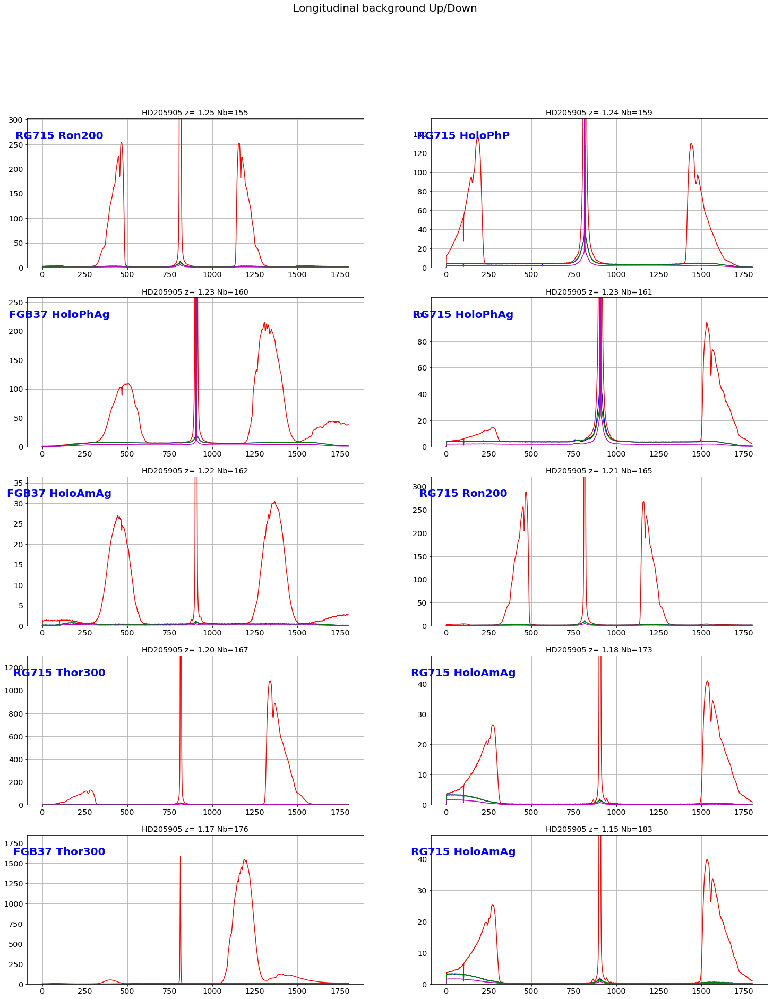

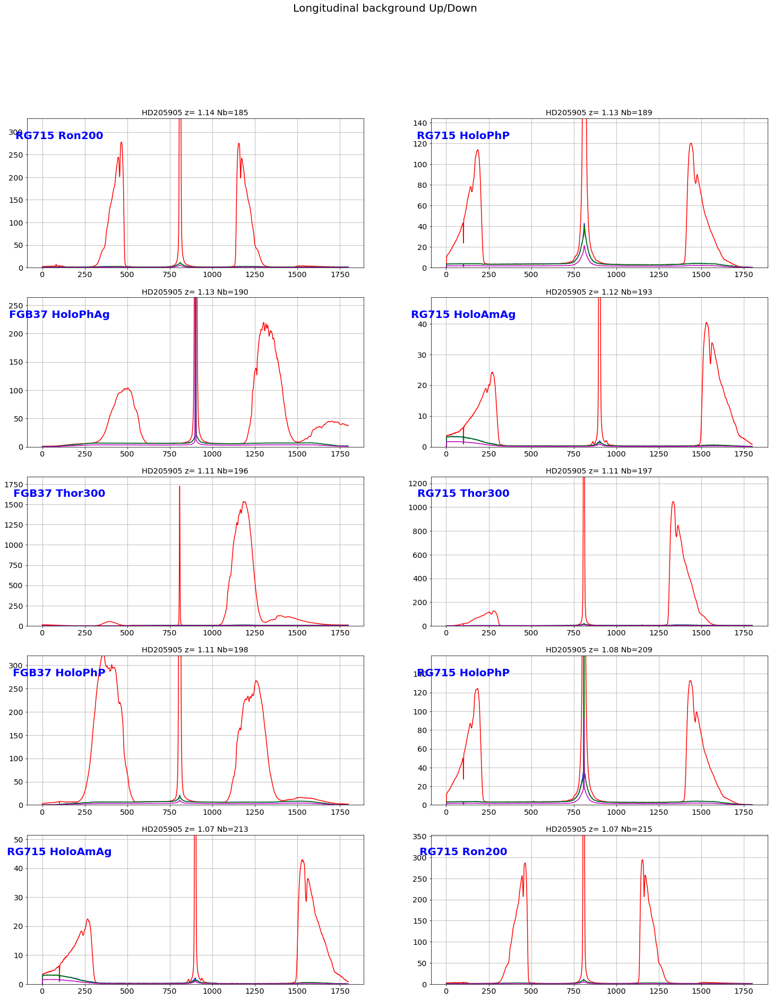

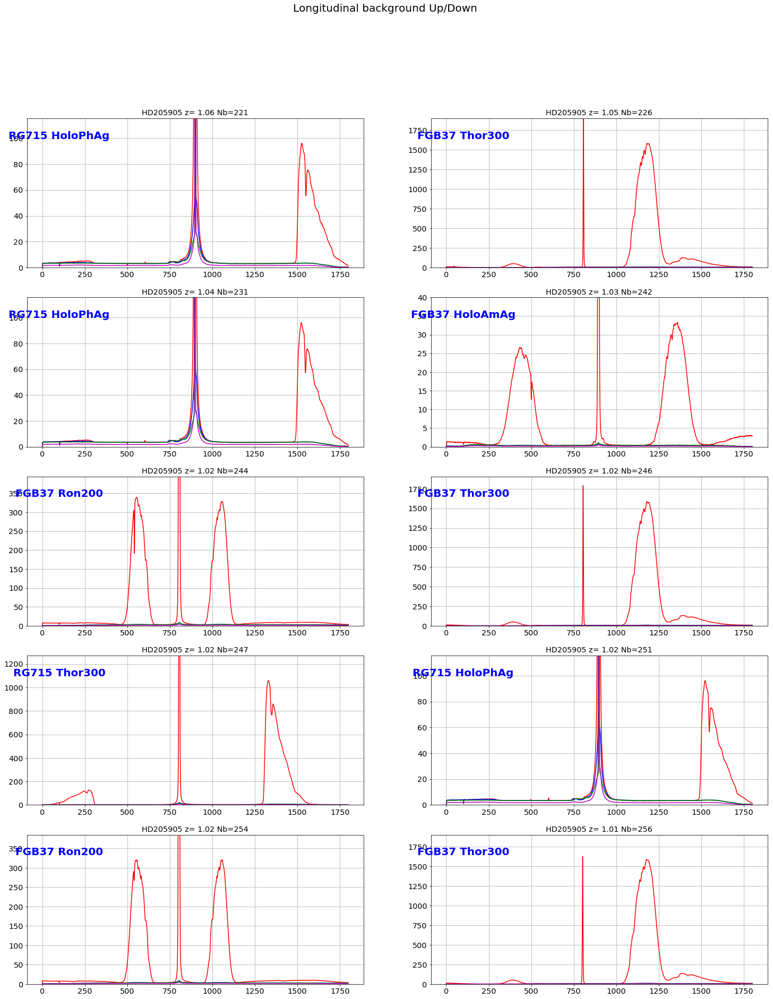

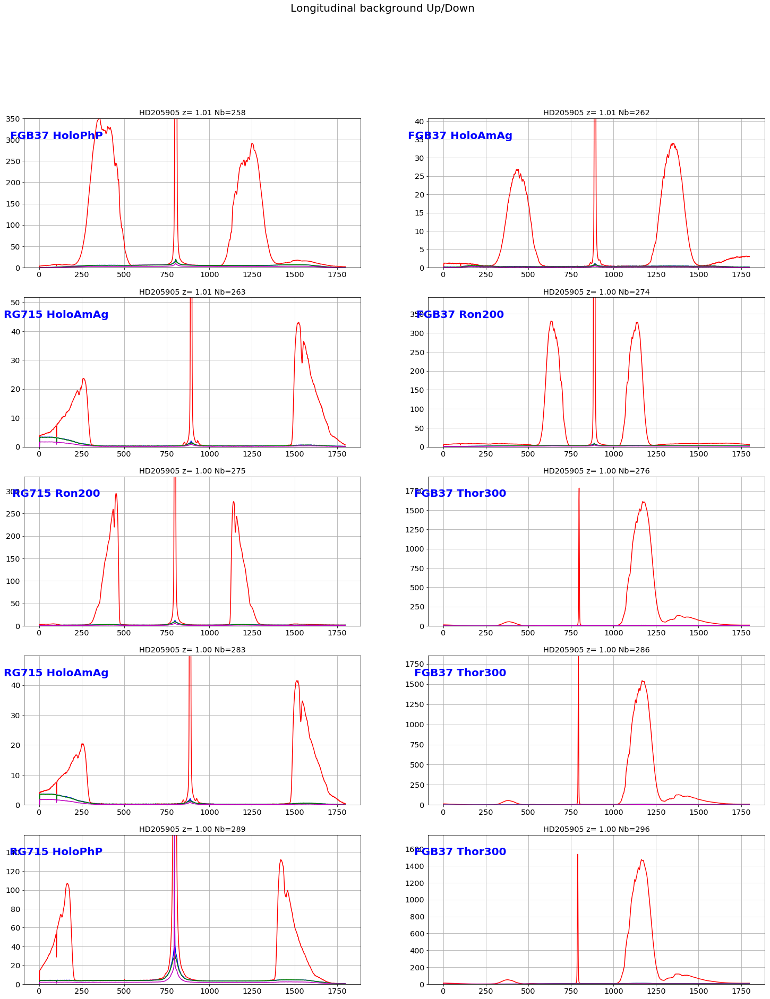

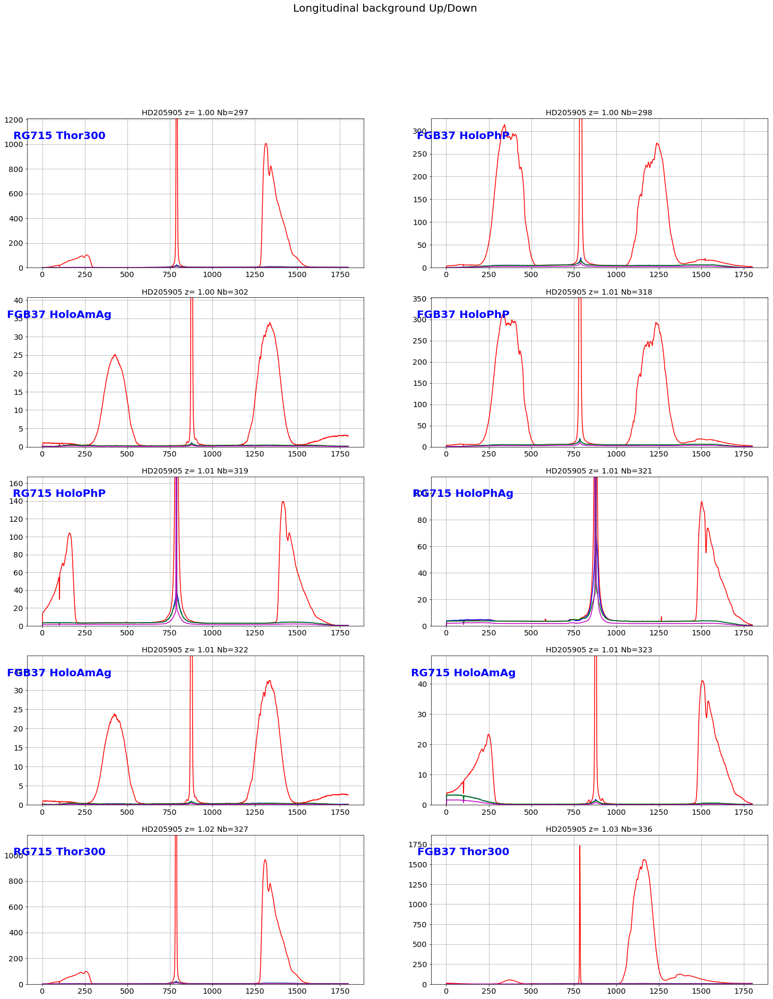

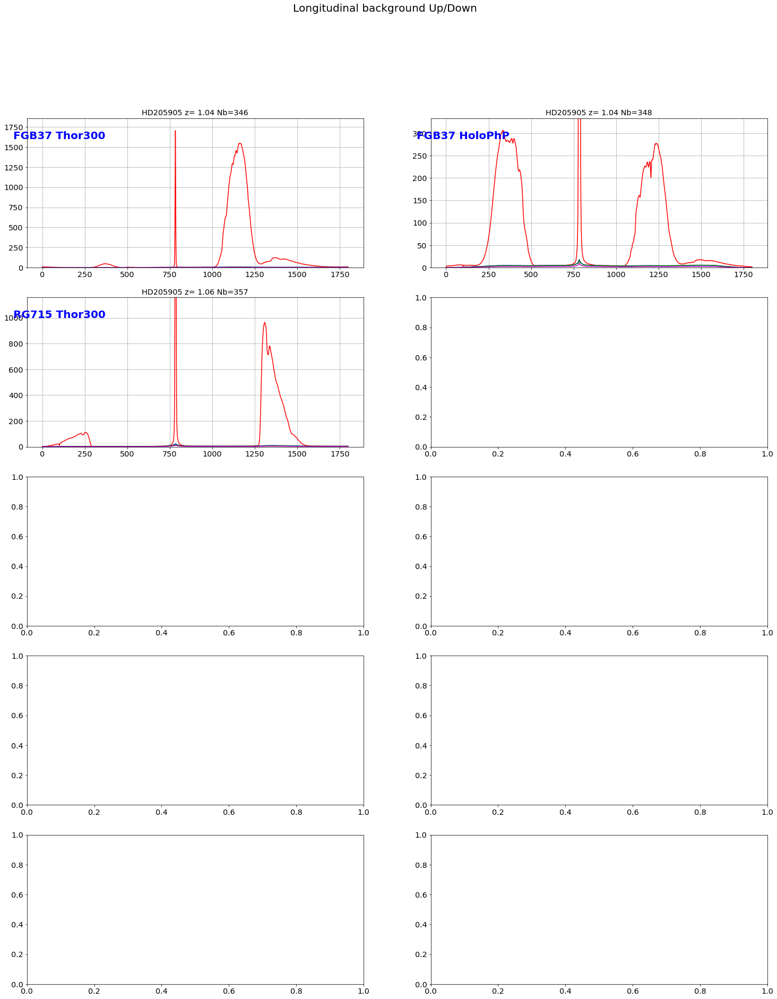

In [104]:
ShowFullLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,object_name,2,dir_top_images)

## If OK apply background subtraction

In [105]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

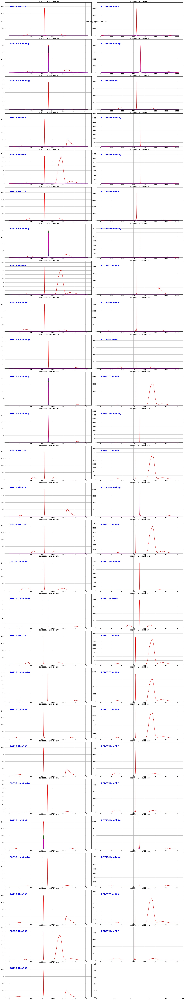

In [106]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)
figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
plt.savefig(figfilename)   

(0, 100.0)

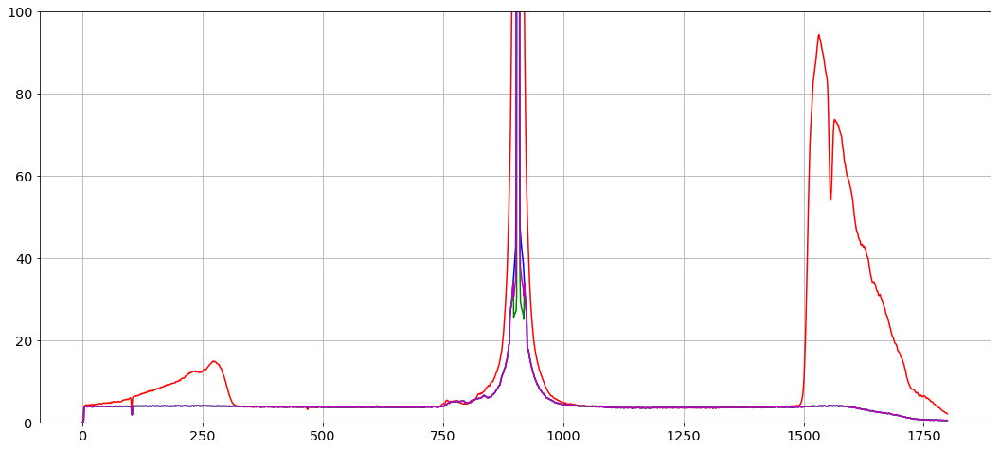

In [107]:
sel=3
plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(Clean_Up[sel],'b-') 
plt.plot(Clean_Do[sel],'g-')
plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,100.)

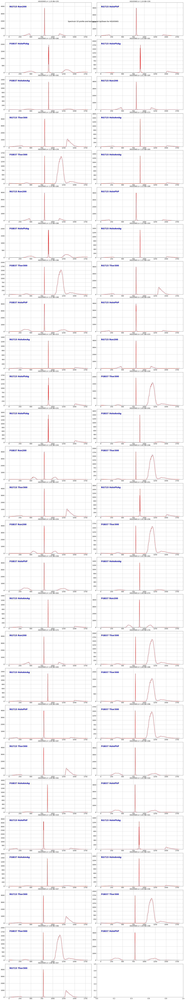

In [108]:
thecorrspectra=CorrectSpectrumFromBackground(thespectra,Clean_Av)

ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2)
figfilename=os.path.join(dir_top_images,'correctedspectrum_profile.pdf')
plt.savefig(figfilename) 

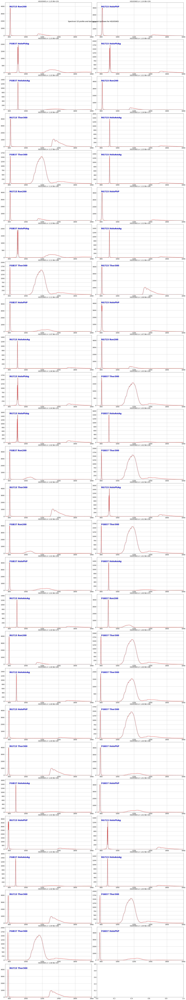

In [109]:
ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2,xlim=(750,1800))
figfilename=os.path.join(dir_top_images,'correctedspectrum_rightprofile.pdf')
plt.savefig(figfilename) 


## The real extraction will be done in another notebook

At this stage the work of extraction and rotation seems very good
